In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib as mpl
from IPython.display import display


In [3]:
# --------------------------------------------------------------
# Load data
# --------------------------------------------------------------
df = pd.read_pickle("../../data/interim/01_data_resampled.pkl")

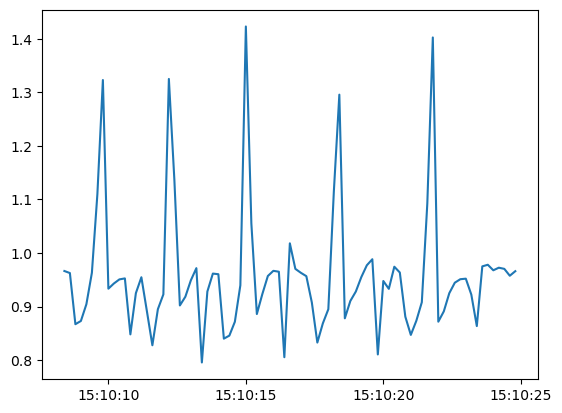

In [9]:

# --------------------------------------------------------------
# Plot single columns
# --------------------------------------------------------------

set_df = df[df["set"] == 1]
plt.plot(set_df["acc_y"])

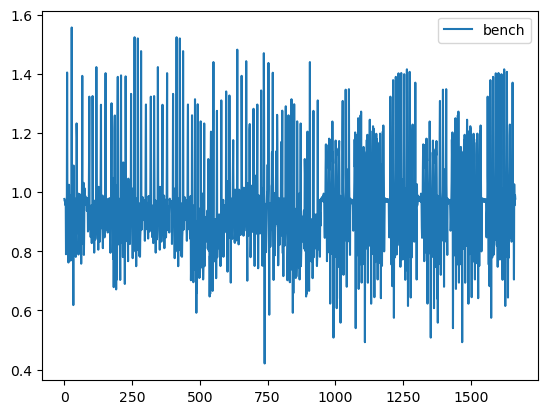

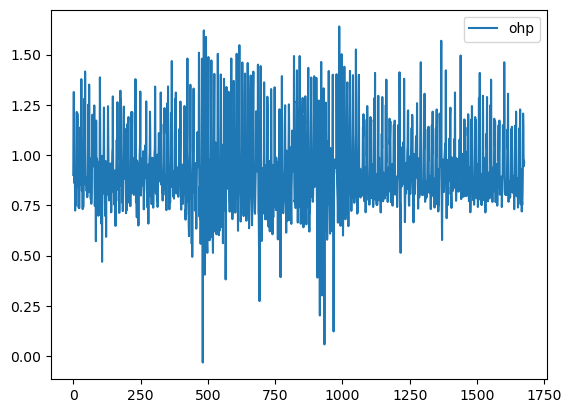

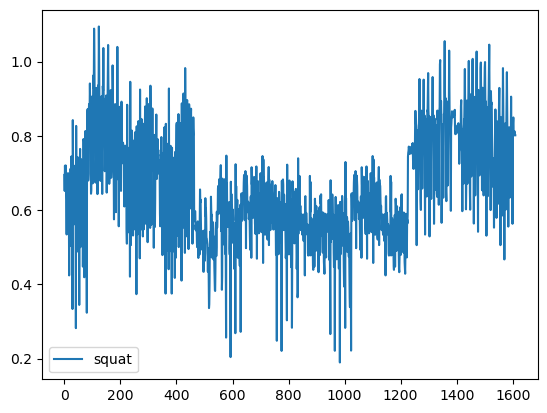

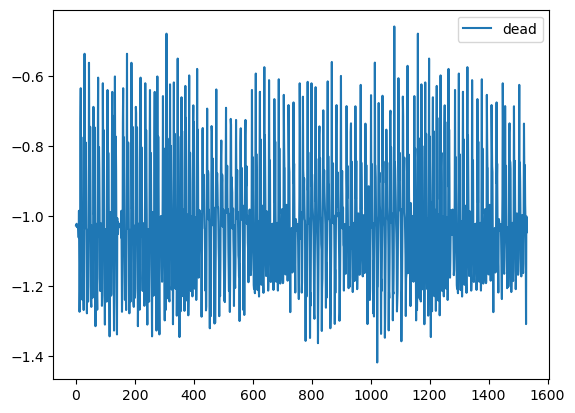

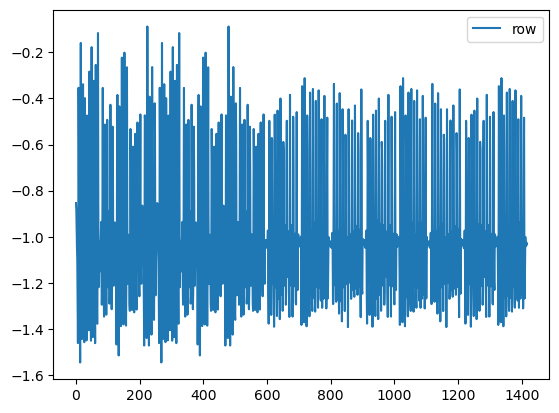

...

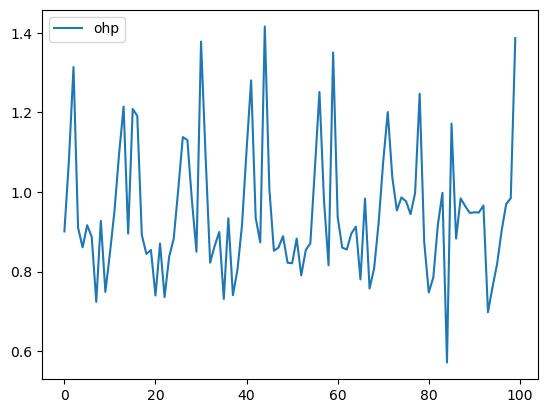

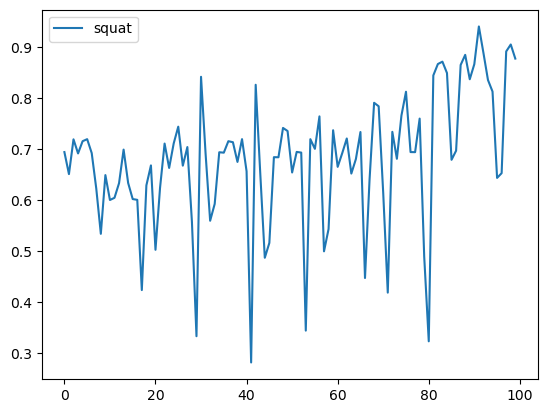

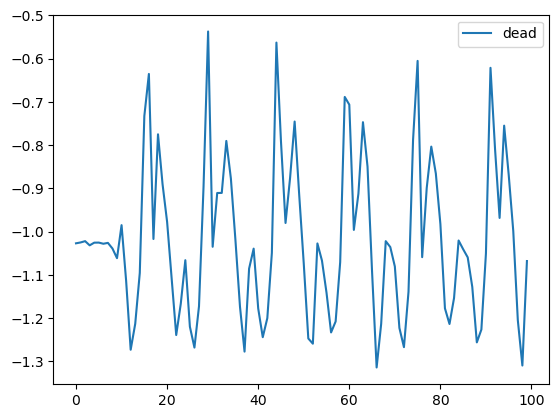

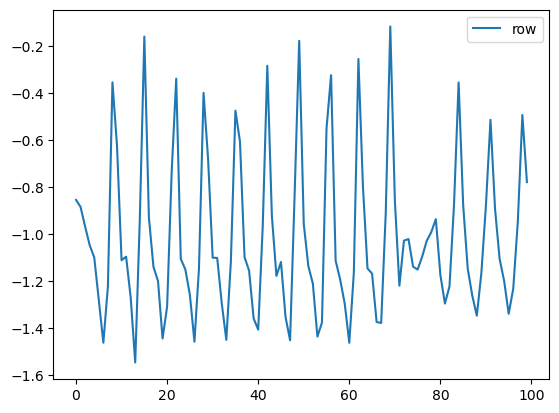

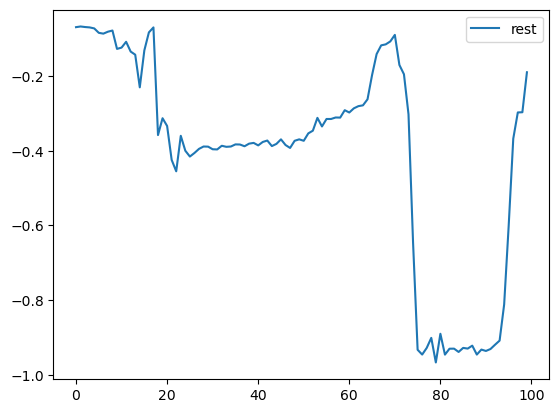

In [10]:
# --------------------------------------------------------------
# Plot all exercises
# --------------------------------------------------------------

for label in df["label"].unique():
    subset = df[df["label"] == label]
    fig, ax = plt.subplots()
    plt.plot(subset["acc_y"].reset_index(drop=True), label=label)
    plt.legend()
    plt.show()

for label in df["label"].unique():
    subset = df[df["label"] == label]
    fig, ax = plt.subplots()
    plt.plot(subset[:100]["acc_y"].reset_index(drop=True), label=label)
    plt.legend()
    plt.show()

In [11]:
# --------------------------------------------------------------
# Adjust plot settings
# --------------------------------------------------------------

mpl.style.use("seaborn-v0_8-deep")
mpl.rcParams["figure.figsize"] = (20, 5)
mpl.rcParams["figure.dpi"] = 100

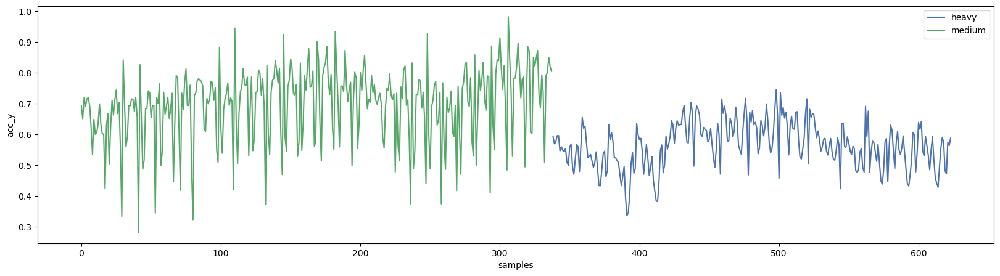

In [12]:
# --------------------------------------------------------------
# Compare medium vs. heavy sets
# --------------------------------------------------------------

category_df = df.query("label == 'squat'").query("participant == 'A'").reset_index()

fig, ax = plt.subplots()
category_df.groupby(["category"])["acc_y"].plot()
ax.set_xlabel("samples")
ax.set_ylabel("acc_y")
plt.legend()


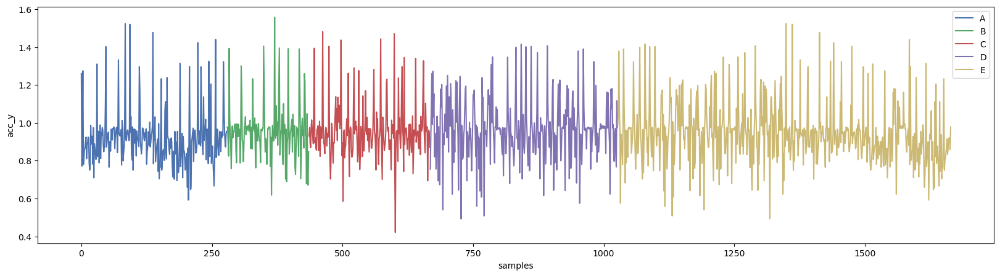

In [13]:
# --------------------------------------------------------------
# Compare participants
# --------------------------------------------------------------

participant_df = df.query("label == 'bench'").sort_values("participant").reset_index()


fig, ax = plt.subplots()
participant_df.groupby(["participant"])["acc_y"].plot()
ax.set_xlabel("samples")
ax.set_ylabel("acc_y")
plt.legend()


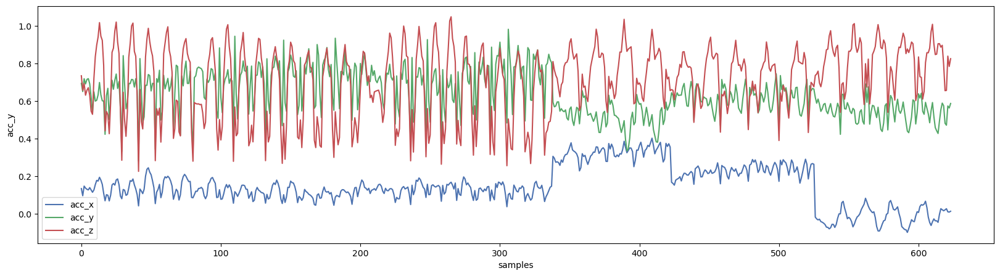

In [14]:

# --------------------------------------------------------------
# Plot multiple axis
# --------------------------------------------------------------

label = "squat"
participant = "A"
all_axis_df = (
    df.query(f"label == '{label}'")
    .query(f"participant == '{participant}'")
    .reset_index()
)

fig, ax = plt.subplots()
all_axis_df[["acc_x", "acc_y", "acc_z"]].plot(ax=ax)
ax.set_xlabel("samples")
ax.set_ylabel("acc_y")
plt.legend()

C:\Users\GTR\AppData\Local\Temp\ipykernel_788\2598173524.py:16: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots()


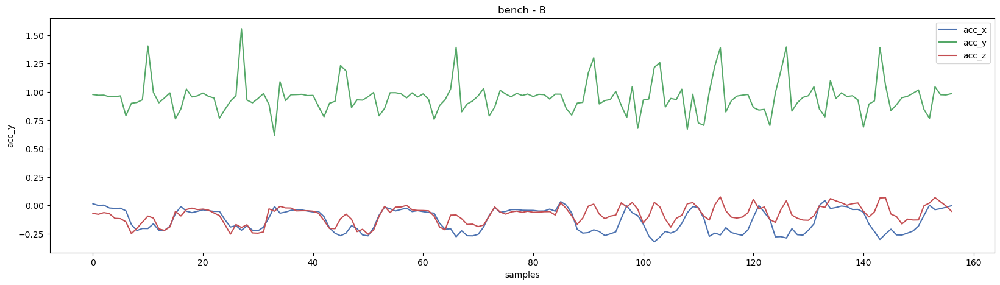

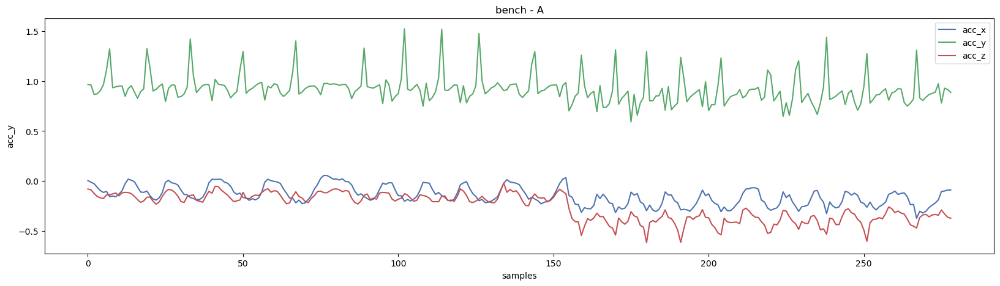

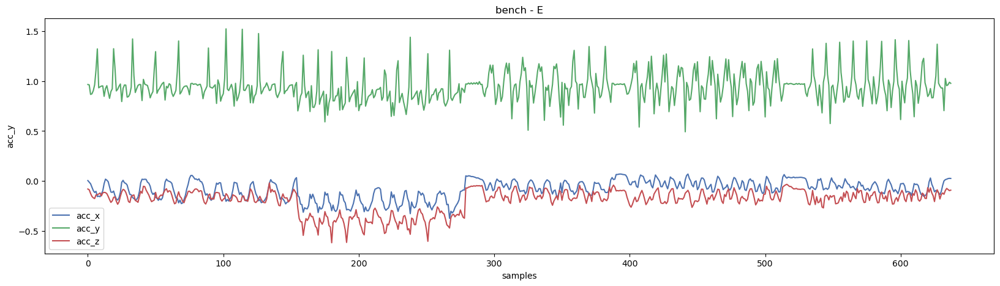

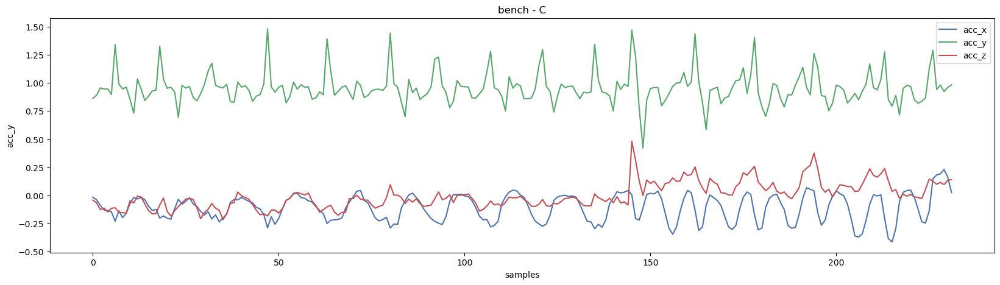

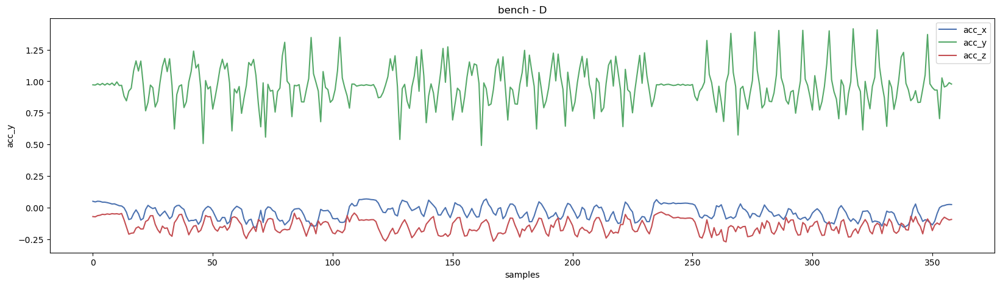

...

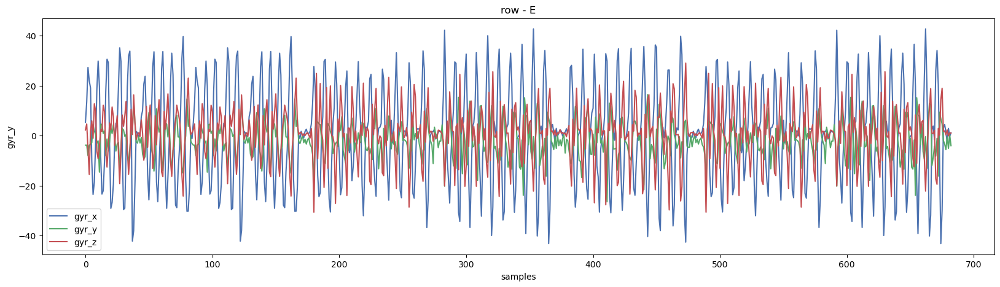

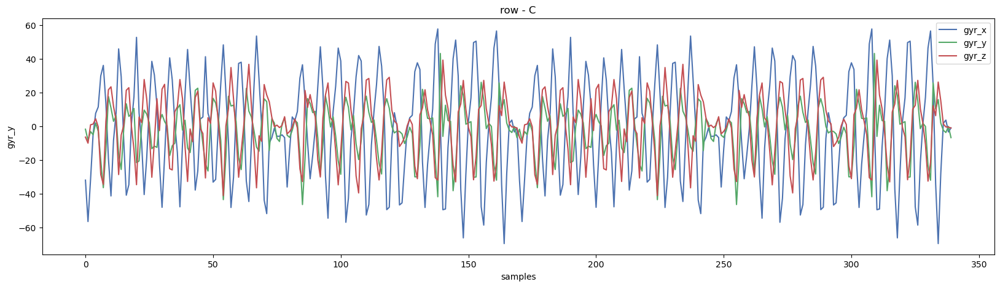

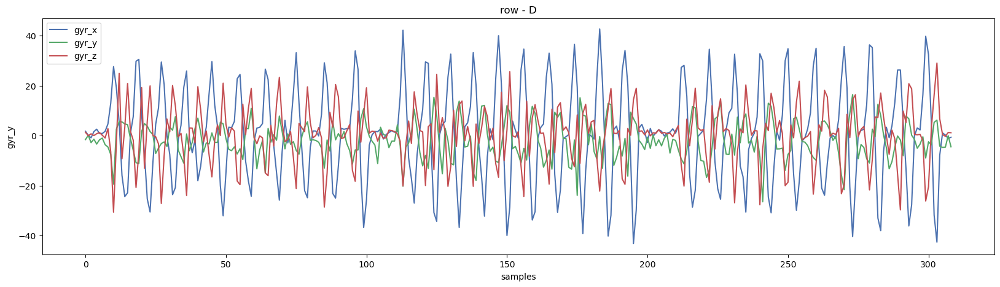

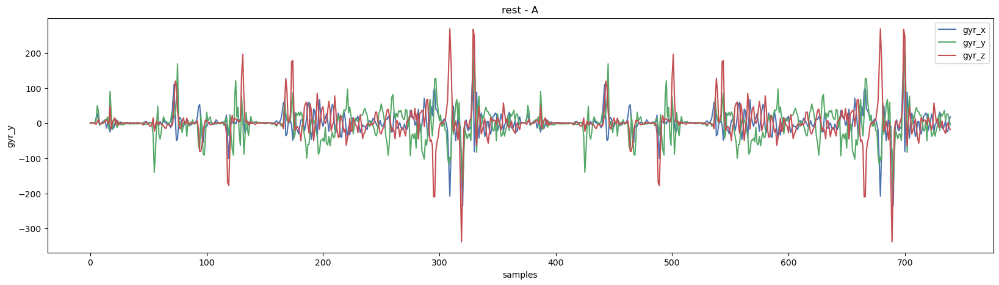

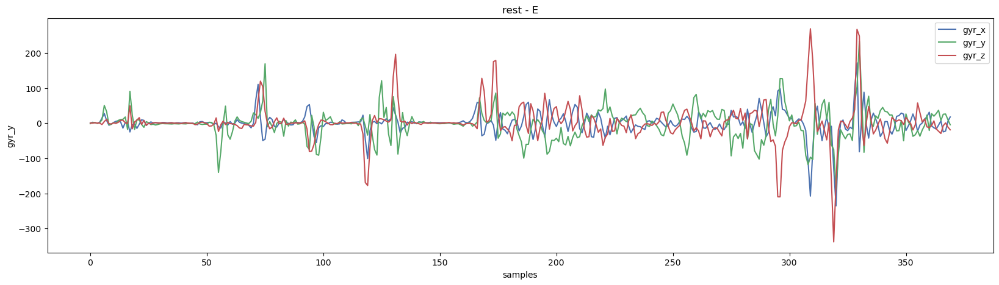

In [15]:
# --------------------------------------------------------------
# Create a loop to plot all combinations per sensor
# --------------------------------------------------------------

labels = df["label"].unique()
participants = df["participant"].unique()

for label in labels:
    for participant in participants:
        all_axis_df = (
            df.query(f"label == '{label}'")
            .query(f"participant == '{participant}'")
            .reset_index()
        )
        if len(all_axis_df) > 0:
            fig, ax = plt.subplots()
            all_axis_df[["acc_x", "acc_y", "acc_z"]].plot(ax=ax)
            ax.set_xlabel("samples")
            ax.set_ylabel("acc_y")
            plt.title(f"{label} - {participant}")
            plt.legend()

for label in labels:
    for participant in participants:
        all_axis_df = (
            df.query(f"label == '{label}'")
            .query(f"participant == '{participant}'")
            .reset_index()
        )
        if len(all_axis_df) > 0:
            fig, ax = plt.subplots()
            all_axis_df[["gyr_x", "gyr_y", "gyr_z"]].plot(ax=ax)
            ax.set_xlabel("samples")
            ax.set_ylabel("gyr_y")
            plt.title(f"{label} - {participant}")
            plt.legend()



Text(0.5, 0, 'samples')

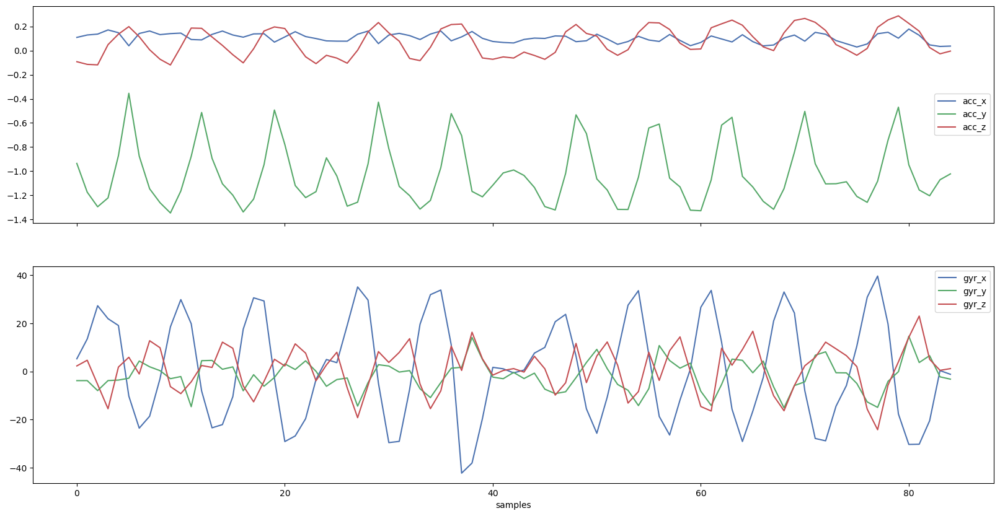

In [16]:

# --------------------------------------------------------------
# Combine plots in one figure
# --------------------------------------------------------------

label = "row"
participant = "A"
combined_df = (
    df.query(f"label == '{label}'")
    .query(f"participant == '{participant}'")
    .reset_index(drop=True)
)

fig, ax = plt.subplots(nrows=2, sharex=True, figsize=(20, 10))
combined_df[["acc_x", "acc_y", "acc_z"]].plot(ax=ax[0])
combined_df[["gyr_x", "gyr_y", "gyr_z"]].plot(ax=ax[1])

ax[0].legend()
ax[1].legend()
ax[1].set_xlabel("samples")

C:\Users\GTR\AppData\Local\Temp\ipykernel_788\645931916.py:17: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(nrows=2, sharex=True, figsize=(20, 10))


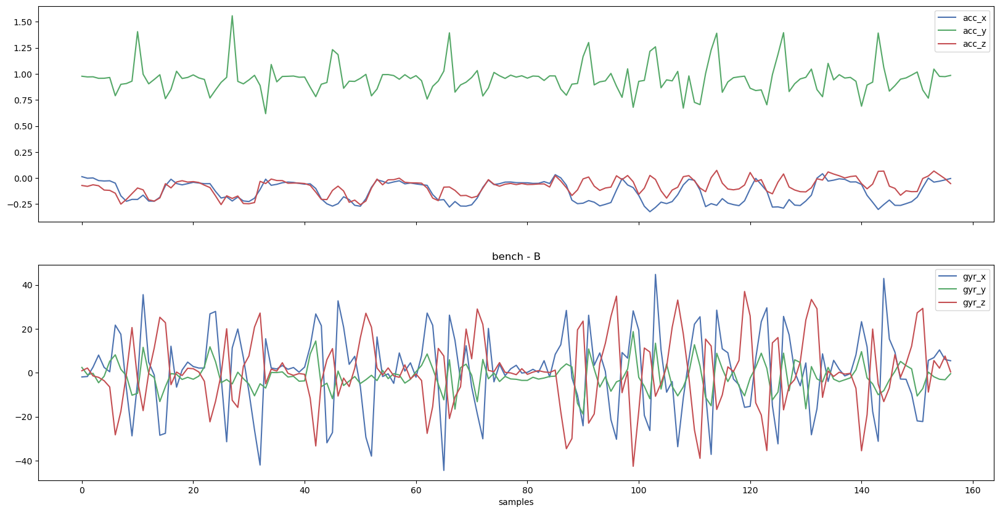

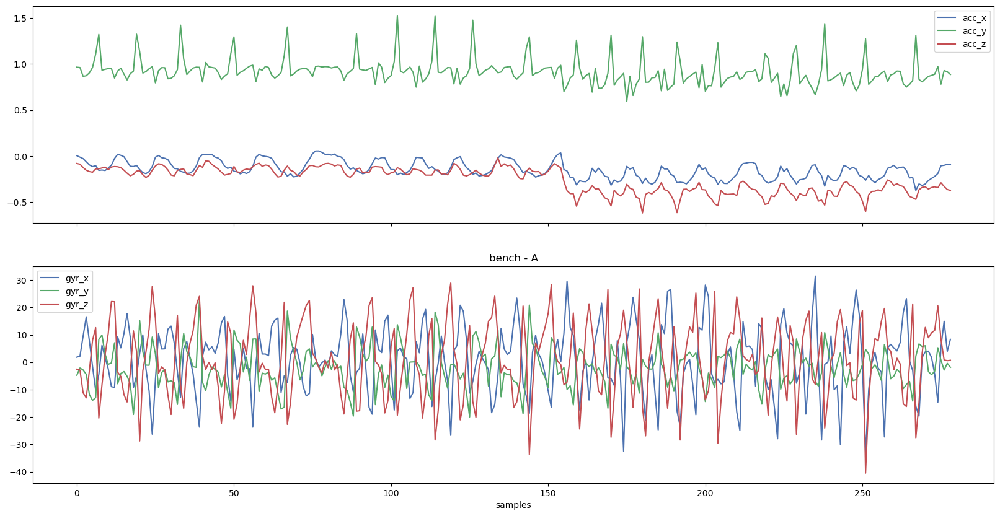

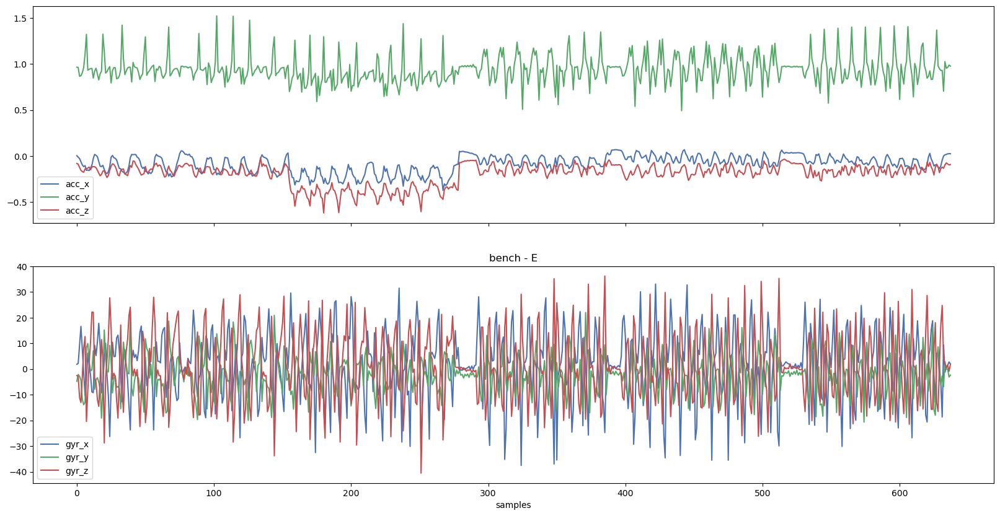

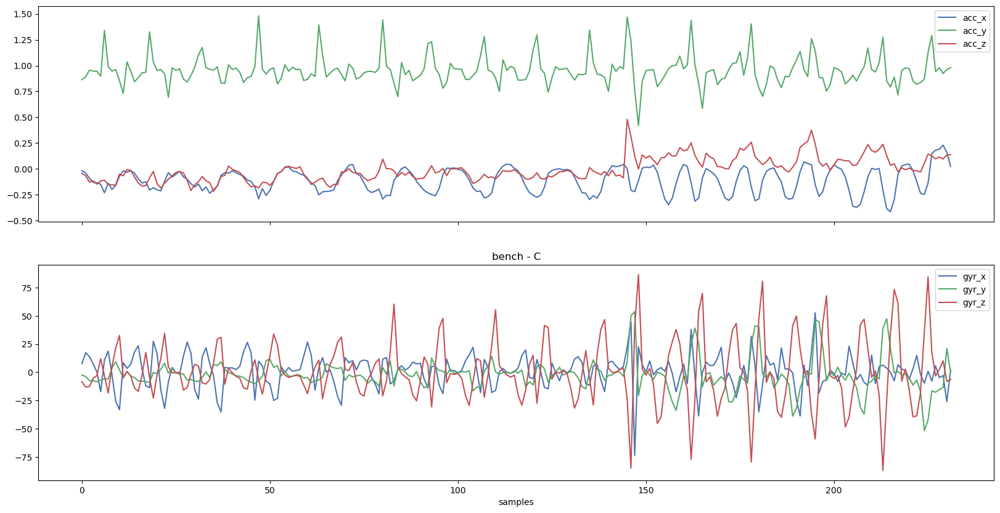

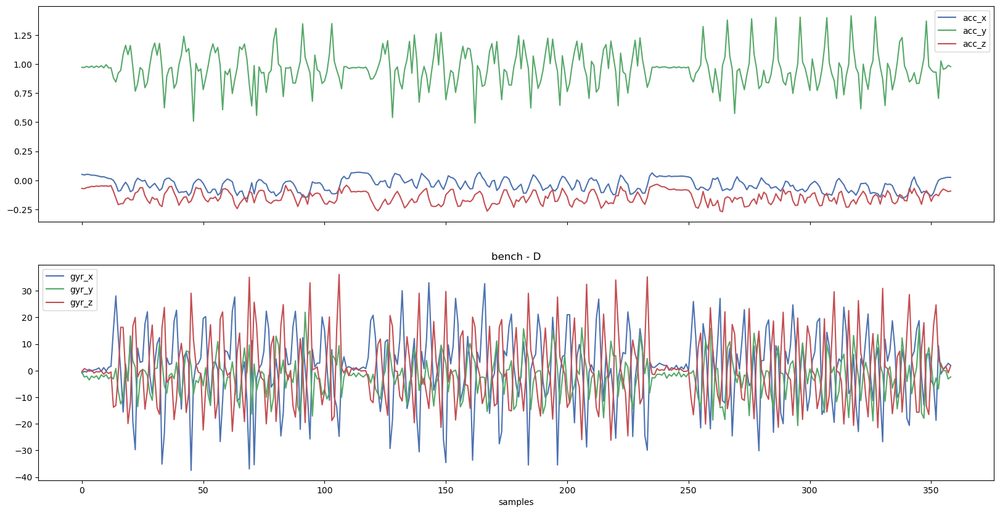

...

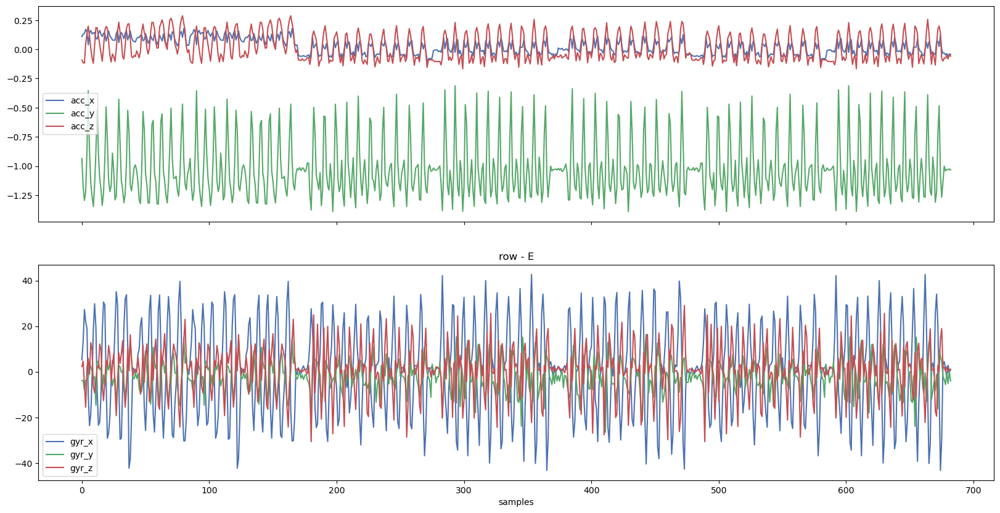

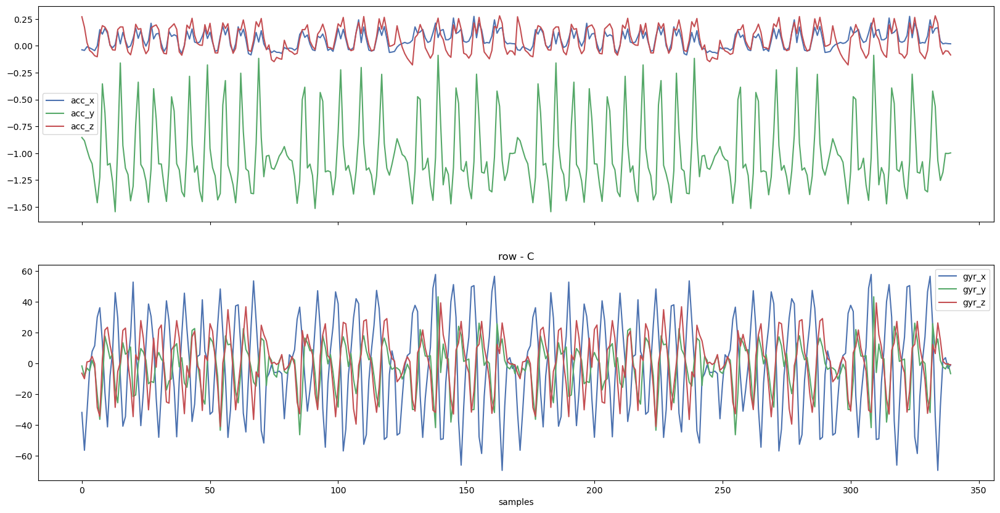

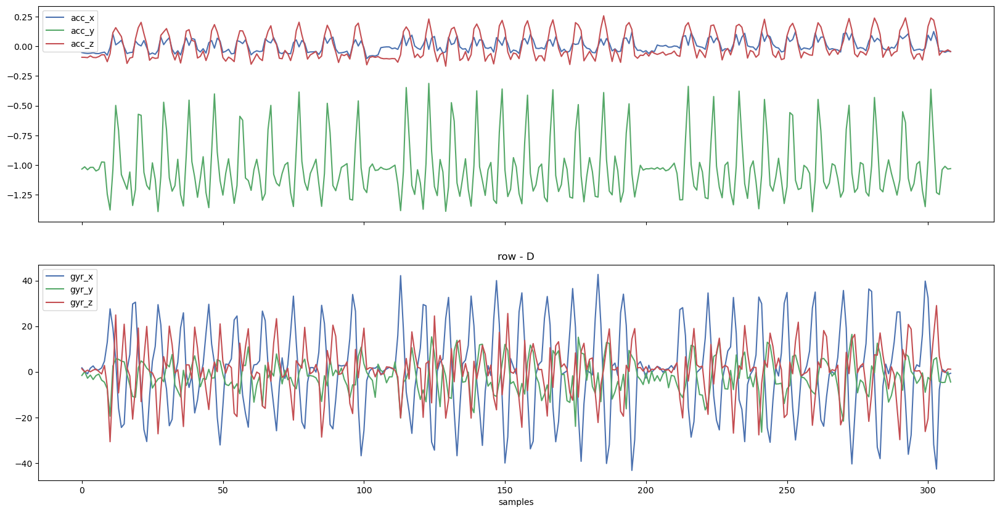

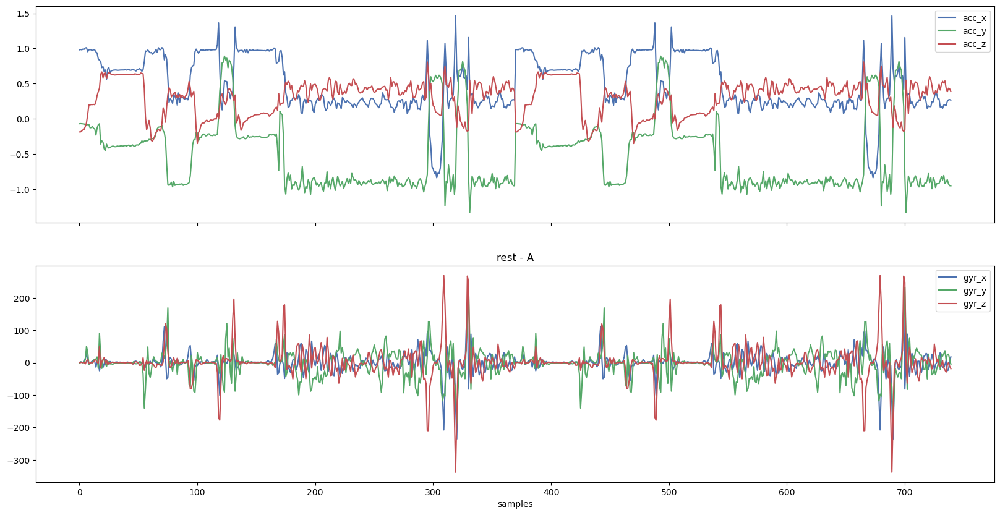

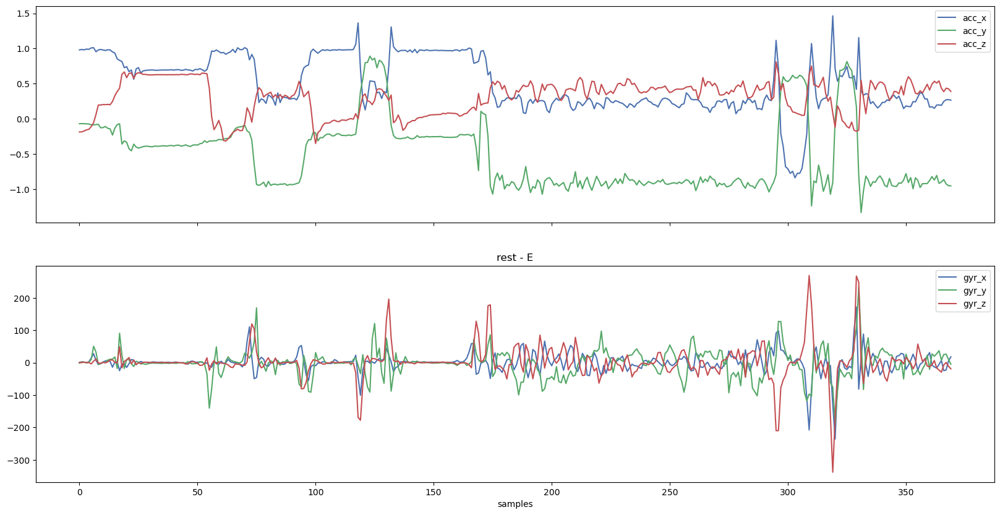

In [19]:
# --------------------------------------------------------------
# Loop over all combinations and export for both sensors
# --------------------------------------------------------------

labels = df["label"].unique()
participants = df["participant"].unique()

for label in labels:
    for participant in participants:
        combined_df = (
            df.query(f"label == '{label}'")
            .query(f"participant == '{participant}'")
            .reset_index(drop=True)
        )
        if len(combined_df) > 0:

            fig, ax = plt.subplots(nrows=2, sharex=True, figsize=(20, 10))
            combined_df[["acc_x", "acc_y", "acc_z"]].plot(ax=ax[0])
            combined_df[["gyr_x", "gyr_y", "gyr_z"]].plot(ax=ax[1])

            ax[0].legend()
            ax[1].legend()
            ax[1].set_xlabel("samples")
            plt.title(f"{label} - {participant}")
            plt.savefig(f"../../reports/figures/{label}_{participant}.png")
            plt.show()
